# 5. ML Modelling

In [1]:
import os
import re
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import requests
from io import BytesIO
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import pairwise_distances
from tqdm import tqdm

#importing functions from text_utils.py
from text_utils import generate_recommendations, read_glove_vecs, coc_matrix

import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_pickle('data/28k_preprocessed_data')
print(f"Number of apparels in the preprocessed data : {data.shape[0]}")
print(f"Number of features describing each apparel  : {data.shape[1]}")

Number of apparels in the preprocessed data : 27918
Number of features describing each apparel  : 6


In [3]:
data.columns

Index(['asin', 'brand', 'color', 'product_type_name', 'medium_image_url',
       'title'],
      dtype='object')

In [4]:
data.head()

,asin,brand,color,product_type_name,medium_image_url,title
118987,B008D30AGK,Out+of+Print+Clothing,multicolored,SHIRT,https://images-na.ssl-images-amazon.com/images...,retro book cover womens slim fit tshirt out pr...
149224,B01E0XLYHA,GreaterGood,blue,SHIRT,https://images-na.ssl-images-amazon.com/images...,ask about granddog tshirt
78827,B003IDE8XQ,Maggie's Organics,grey,HOME,https://images-na.ssl-images-amazon.com/images...,camisoles grey medium fair labor pc
50056,B00CQ83SDA,Organically Grown,slate blue,SHIRT,https://images-na.ssl-images-amazon.com/images...,dandelion virtue womens organic dolman top org...
407,B016OZOHIK,Fluffy co.,putty,APPAREL,https://images-na.ssl-images-amazon.com/images...,desert flash crop top hip design made usa


__Utility functions to generate the recommendations given the features.__

In [5]:
def display_image(url):
    
    """
    function to display the image
    """
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    plt.imshow(img)
    
def get_word_scores(title, word_vec_map, word_idf_map):
    
    """
    function to compute the word idf scores
    """
    
    title_words = title.split()
    #print(title_words)
    score_vec = {}
    for word in title_words:
        if (word in word_vec_map) and (word in word_idf_map):
            word_vec = word_idf_map[word] * word_vec_map[word]
            score_vec[word] = word_vec
        
    return score_vec  #dict

def plot_heatmap_image(words, scores, img_url, title_text):
    
    """
    words       :  list of words of the recommended apparel's title\n
    scores      :  scores of each word from bow/tfidf\n
    img_url     :  image url of the recommended title\n
    title_text  :  title of the recommended apparel\n
    """
    
    fig = plt.figure(0, figsize=(20, 3), dpi=1500)
    #plot for heatmap
    ax1 = plt.subplot2grid((1, 3), (0,0), colspan=2)
    ax1.set_title(title_text)
    sns.heatmap(np.array([scores]), annot=True, ax=ax1)
    #print(words)
    ax1.set_xticklabels(words)
    
    #plot for image
    ax2 = plt.subplot2grid((1, 3), (0, 2))
    # we don't want any grid lines for image and no labels on x-axis and y-axis
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax2.axis('off')
    try:
        display_image(img_url)
        #no image
    except Exception:
        display_image('https://upload.wikimedia.org/wikipedia/commons/thumb/a/ac/No_image_available.svg/450px-No_image_available.svg.png')
    plt.show()
    
def plot_heatmap_image_idf(word_vec_map, word_idf_map, title1, title2, img_url):
    
    """
    function to plot the word idf similarity matrix
    """
    
    s1 = get_word_scores(title1, word_vec_map, word_idf_map)
    s2 = get_word_scores(title2, word_vec_map, word_idf_map)
    
    s1_s2_dist = np.round(pairwise_distances(list(s1.values()), list(s2.values()), metric='cosine'), 2)
    
    fig = plt.figure(0, figsize=(20, 6))
    ax1 = plt.subplot2grid((1, 3), (0,0), colspan=2)
    ax1.set_title(title2)
    sns.heatmap(s1_s2_dist, annot=True, ax=ax1)
    #print(words)
    ax1.set_xticklabels(list(s2.keys()))
    ax1.set_yticklabels(list(s1.keys()))
    
    #plot for image
    ax2 = plt.subplot2grid((1, 3), (0, 2))
    # we don't want any grid lines for image and no labels on x-axis and y-axis
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax2.axis('off')
    display_image(img_url)
    plt.show()
    
    
def plot_apparel(feat_type, title1, title2, img_url, query=None,\
                 vectorizer=None, vectorized_data=None, word_vec_map=None,\
                 word_idf_map=None):
    
    """
    function to plot the heatmap and apparel
    """
    
    #title to occurence dict in case of bow/tfidf
    vector1 = Counter(title1.split())
    vector2 = Counter(title2.split())
    #print(vector1)
    #print(vector2)
    
    #set of common_words from both titles
    common_words = set(vector1.keys()) & set(vector2.keys())
    
    #we'll set the values of non common words to zero
    #To show the difference in heatmap
    for word in vector2:
        if word not in common_words:
            vector2[word] = 0
        
    if feat_type == 'bow':
        words = list(vector2.keys())
        scores = list(vector2.values())
        plot_heatmap_image(words, scores, img_url, title2)
    
    #tfidf
    elif feat_type == 'tfidf':
        words = list(vector2.keys())
        scores = []
        for word in vector2.keys():
            tfidf_score = vectorized_data[query, vectorizer.vocabulary_[word]]
            scores.append(tfidf_score)
        plot_heatmap_image(words, scores, img_url, title2)
            
    elif feat_type == 'w2v':
        plot_heatmap_image_idf(word_vec_map, word_idf_map, title1, title2, img_url)
        

def generate_recommendations(data, query, num_rec, feat_type, vectorized_data,\
                             vectorizer=None, word_vec_map=None, word_idf_map=None,\
                             extra_features=None, weights=None):
    
    """
    data(pandas df)             :   original dataframe\n
    query(int)                  :   index of query\n
    num_rec(int)                :   number of recommendations to be shown\n
    feat_type(str)              :   if type of featurization (Bag Of Words : 'bow', TFIDF : 'tfidf', any_W2v : 'w2v')\n
    vectorized_data(array)      :   bow_data, tfidf_data, w2v_data\n
    vectorizer(sklearn object)  :   if {'bow' : instance of CountVectorizer, 'tfidf' : instance of TdIdfVectorizer} else None\n
    word_vec_map(dict)          :   if feat_type == 'w2v' else None\n
    word_idf_map(dict)          :   if feat_type == 'w2v' else None\n
    extra_features(tuple)       :   if feat_type == 'w2v'
    weights(array)              :   if extra_features is not None[text, brand, color, image]
    
    """
    
    pairwise_dists = pairwise_distances(vectorized_data[query].reshape(1, -1), vectorized_data, metric='euclidean')
    
    if extra_features is not None:
        if len(extra_features) == 2:
            brand_features, color_features = extra_features
            brand_dists = pairwise_distances(brand_features[query].reshape(1, -1), brand_features, metric='euclidean')
            color_dists = pairwise_distances(color_features[query].reshape(1, -1), color_features, metric='euclidean')
            pairwise_dists = (weights[0]*pairwise_dists + weights[1]*brand_dists + weights[2]*color_dists) / sum(weights)
            
        #for image features
        if len(extra_features) == 3:
            brand_features, color_features, image_features = extra_features
            brand_dists = pairwise_distances(brand_features[query].reshape(1, -1), brand_features, metric='euclidean')
            color_dists = pairwise_distances(color_features[query].reshape(1, -1), color_features, metric='euclidean')
            img_dists = pairwise_distances(image_features[query].reshape(1, -1), image_features, metric='euclidean')
            pairwise_dists = (weights[0]*pairwise_dists + weights[1]*brand_dists +\
                              weights[2]*color_dists + weights[3]*img_dists) / sum(weights)
            
    min_dist_indices = pairwise_dists.flatten().argsort()[0 : num_rec+1]
    min_dists = pairwise_dists.flatten()[min_dist_indices]
    df_title_indices = data.index[min_dist_indices].values
    
    for i in range(len(df_title_indices)):
        plot_apparel(feat_type,
                     data.title.loc[df_title_indices[0]],
                     data.title.loc[df_title_indices[i]],
                     data.medium_image_url.loc[df_title_indices[i]],
                     query,
                     vectorizer,
                     vectorized_data,
                     word_vec_map,
                     word_idf_map)
        
        print(f"ASIN         : {data.asin.loc[df_title_indices[i]]}")
        print(f"BRAND        : {data.brand.loc[df_title_indices[i]]}")
        print(f"COLOR        : {data.color.loc[df_title_indices[i]]}")
        print(f"TITLE        : {data.title.loc[df_title_indices[i]]}")
        print(f"COS/EUC_DIST : {min_dists[i] : .2f}")
        print('='*130)
        

## 5.1 Text based product similarty

* Here we'll use a bunch of techniques to represent the title in vector format.
    - 1. Bag Of Words
    - 2. Tf - Idf
    - 3. IDF weighted GloVe

### 5.1.1 Product similarity using Bag Of Words

In [6]:
bow = CountVectorizer()
title_bow = bow.fit_transform(data.title)

print(f"Number of unique words in title : {len(bow.get_feature_names())}")

Number of unique words in title : 17234


In [7]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=21256, num_rec=8, feat_type='bow', vectorized_data=title_bow)

ASIN         : B0719W2F5P
BRAND        : FitCrush Lifestyle
COLOR        : purple
TITLE        : stop wishing start doing racerback tank top
COS/EUC_DIST :  0.00


ASIN         : B00ZYIEIFG
BRAND        : Agiato Apparel
COLOR        : black
TITLE        : agiato womens racerback tank top
COS/EUC_DIST :  2.45


ASIN         : B06W58XL2M
BRAND        : Venley
COLOR        : multi
TITLE        : holly womens racerback tank top
COS/EUC_DIST :  2.45


ASIN         : B00FGS4YAI
BRAND        : Salomon
COLOR        : orchid lila/clearwater blue
TITLE        : salomon womens start tank top
COS/EUC_DIST :  2.45


ASIN         : B072QZW9BR
BRAND        : Budweiser
COLOR        : red
TITLE        : budweiser racerback ladies tank top
COS/EUC_DIST :  2.45


ASIN         : B01MDU2A5S
BRAND        : Vivienne Tam
COLOR        : purple
TITLE        : printed sequin tank top
COS/EUC_DIST :  2.65


ASIN         : B003GAME0K
BRAND        : Hyde
COLOR        : black
TITLE        : hyde womens top tank
COS/EUC_DIST :  2.65


ASIN         : B072WCS514
BRAND        : Tribal
COLOR        : stone
TITLE        : tank top stone tribal
COS/EUC_DIST :  2.65


ASIN         : B073SH2F45
BRAND        : Haute Hippie
COLOR        : black
TITLE        : bead embellished racerback tank
COS/EUC_DIST :  2.65


In [8]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=2859, num_rec=8, feat_type='bow', vectorized_data=title_bow)

ASIN         : B00JXQAC2I
BRAND        : Si Row
COLOR        : white
TITLE        : black white tiger tshirt with tiger stripes xl xxl
COS/EUC_DIST :  0.00


ASIN         : B00JXQCZO6
BRAND        : Si Row
COLOR        : brown
TITLE        : brown white tiger tshirt with tiger stripes xl
COS/EUC_DIST :  1.73


ASIN         : B00JXQA8D6
BRAND        : Si Row
COLOR        : grey
TITLE        : grey white tiger tshirt with tiger stripes xl
COS/EUC_DIST :  1.73


ASIN         : B00JXQCS52
BRAND        : Si Row
COLOR        : yellow
TITLE        : yellow tiger tshirt with tiger stripes xl
COS/EUC_DIST :  2.00


ASIN         : B00JXQAVN8
BRAND        : Si Row
COLOR        : pink
TITLE        : pink tiger tshirt with zebra stripes xl
COS/EUC_DIST :  2.45


ASIN         : B00JXQANA4
BRAND        : Si Row
COLOR        : blue
TITLE        : blue tiger tshirt with zebra stripes xl
COS/EUC_DIST :  2.45


ASIN         : B00JXQB7IQ
BRAND        : Si Row
COLOR        : brown
TITLE        : burnt umber tiger tshirt with zebra stripes xl
COS/EUC_DIST :  2.65


ASIN         : B0088PMZ16
BRAND        : Red House
COLOR        : deep red
TITLE        : canvas tshirt black xl
COS/EUC_DIST :  3.00


ASIN         : B01NB0NKRO
BRAND        : Ideology
COLOR        : white
TITLE        : ideology graphic tshirt xl white
COS/EUC_DIST :  3.16


__Most of the apparels have the similar design but different patterns.__<br>
__BOW seems to be doing well here because of the local count.__

### 5.1.2 Product similarity using Tf - Idf

In [9]:
tfidf = TfidfVectorizer()
title_tfidf = tfidf.fit_transform(data.title)

print(f"Number of unique words in title : {len(tfidf.get_feature_names())}")

Number of unique words in title : 17234


In [10]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=21256, num_rec=8, feat_type='tfidf', vectorized_data=title_tfidf, vectorizer=tfidf)

ASIN         : B0719W2F5P
BRAND        : FitCrush Lifestyle
COLOR        : purple
TITLE        : stop wishing start doing racerback tank top
COS/EUC_DIST :  0.00


ASIN         : B00FGS4YAI
BRAND        : Salomon
COLOR        : orchid lila/clearwater blue
TITLE        : salomon womens start tank top
COS/EUC_DIST :  1.14


ASIN         : B0745ZHBFB
BRAND        : Shop Delfina
COLOR        : black
TITLE        : cats doing funny yoga poses womens tank top
COS/EUC_DIST :  1.19


ASIN         : B01ENRTHO0
BRAND        : Goodie Two Sleeves
COLOR        : black
TITLE        : stop animal testing women black shirt
COS/EUC_DIST :  1.24


ASIN         : B01BN0Y40W
BRAND        : Colosseum
COLOR        : orange
TITLE        : colosseum womens auburn short stop baseball top
COS/EUC_DIST :  1.24


ASIN         : B00HHIQTX0
BRAND        : Criminal Damage
COLOR        : black
TITLE        : criminal damage womens all start tee medium black
COS/EUC_DIST :  1.24


ASIN         : B01E0TA114
BRAND        : GreaterGood
COLOR        : black
TITLE        : stop puppy mills tshirt
COS/EUC_DIST :  1.25


ASIN         : B01EPDFBZQ
BRAND        : Goodie Two Sleeves
COLOR        : black
TITLE        : stop animal testing shortsleeve womens crew tee
COS/EUC_DIST :  1.26


ASIN         : B01GEMS3FG
BRAND        : Jadelynn Brooke
COLOR        : neon pink
TITLE        : jadelynn brooke fit neon pink donut stop get tank
COS/EUC_DIST :  1.27


In [11]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=10580, num_rec=8, feat_type='tfidf', vectorized_data=title_tfidf, vectorizer=tfidf)

ASIN         : B00XQ9L2CC
BRAND        : Tee's Plus
COLOR        : white
TITLE        : heart awesome daughter bit pixel white juniors soft tshirt
COS/EUC_DIST :  0.00


ASIN         : B06XFFFVM3
BRAND        : Misky & Stone
COLOR        : white
TITLE        : misky stone pixel heart boobs womens tshirt love crewneck tee white sxl
COS/EUC_DIST :  1.16


ASIN         : B01N65Z0U9
BRAND        : Sigh Co. Graphics
COLOR        : black
TITLE        : bit cthulhu womens fitted tshirt
COS/EUC_DIST :  1.18


ASIN         : B074HCYSWK
BRAND        : sunfrog
COLOR        : black
TITLE        : best tshirt bikers daughter
COS/EUC_DIST :  1.20


ASIN         : B071JZBH74
BRAND        : City Chic
COLOR        : orange
TITLE        : pixel rose plus size lace yoke top orange size xs
COS/EUC_DIST :  1.22


ASIN         : B072FH5QTP
BRAND        : Tee's Plus
COLOR        : white
TITLE        : army mom white juniors soft tshirt xsmall
COS/EUC_DIST :  1.23


ASIN         : B01LC7VXTQ
BRAND        : Ai Gebei
COLOR        : pink
TITLE        : womens classy sassy and bit smart long sleeve tshirt
COS/EUC_DIST :  1.24


ASIN         : B00SHWFCSS
BRAND        : Tee's Plus
COLOR        : white
TITLE        : wife loading white soft juniors tshirt
COS/EUC_DIST :  1.25


ASIN         : B06XFQDLTH
BRAND        : musicalheroes
COLOR        : black
TITLE        : all need today little bit coffee tank top women
COS/EUC_DIST :  1.26


__First few apparels were relevant but the some were completely different from the query.__<br>
__BOW seems to be better than TFIDF because of the local count factor.__<br>
__TFIDF recommendations seems to be diverse because of the IDF factor.__

### 5.1.4 Product Similarity GLOVE Weighted by IDF.

* Many of the recommendations from bow and tfidf appear from same brand because of the frequency factor.
* To counter this and for the recommendations to be diverse, we'll use GLOVE weighted by IDF values.
* Each word in the title is represented by a 300D GLoVe weighted by its IDF value.
* The GloVe representation supresses the brand names because most of the brand names do not appear in GloVe Corpus.
* The HeatMap shows the pairwise distance between each word from the title.

In [12]:
_, _, word_vec_map = read_glove_vecs('glove.6B.300d.txt')

In [13]:
word_idf_map = dict(zip(tfidf.get_feature_names(), tfidf.idf_))

In [14]:
def build_glove_vec(data, word_vec_map, word_idf_map):
    
    idf_glove_vecs = np.zeros((data.shape[0], 300))
    
    for idx, title in enumerate(data.title.values):
        vec = np.zeros((300, ))
        w_sum = 0.000001 #prevent ZeroDivisionError
        words = title.strip().split()
        
        for word in words:
            if (word in word_vec_map) and (word in word_idf_map):
                idf_score = word_idf_map[word]
                vec += word_vec_map[word] * idf_score
                w_sum += idf_score
                
        idf_glove_vecs[idx, :] = vec / w_sum
        
    return idf_glove_vecs

In [15]:
idf_glove_vecs = build_glove_vec(data, word_vec_map, word_idf_map)

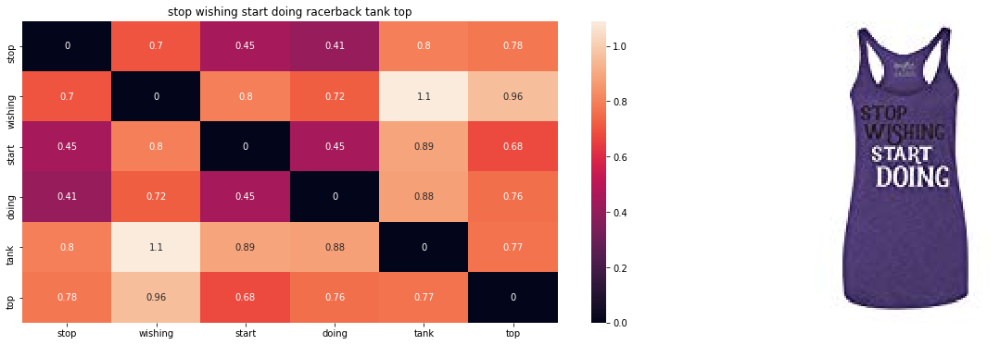

ASIN         : B0719W2F5P
BRAND        : FitCrush Lifestyle
COLOR        : purple
TITLE        : stop wishing start doing racerback tank top
COS/EUC_DIST :  0.00


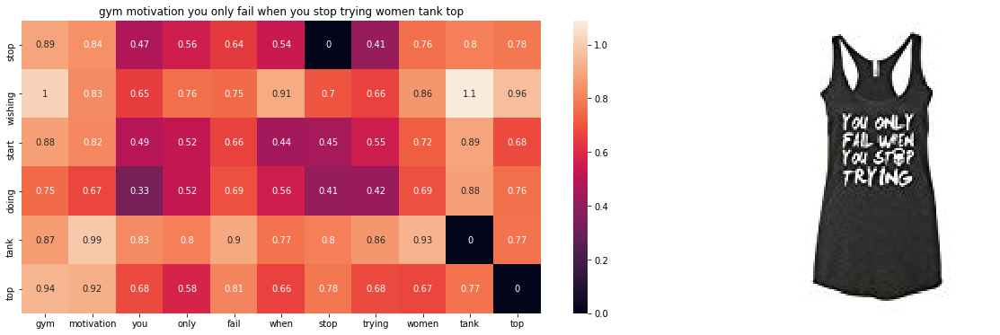

ASIN         : B01CD7F2FK
BRAND        : Gym Motivation
COLOR        : black
TITLE        : gym motivation you only fail when you stop trying women tank top
COS/EUC_DIST :  2.18


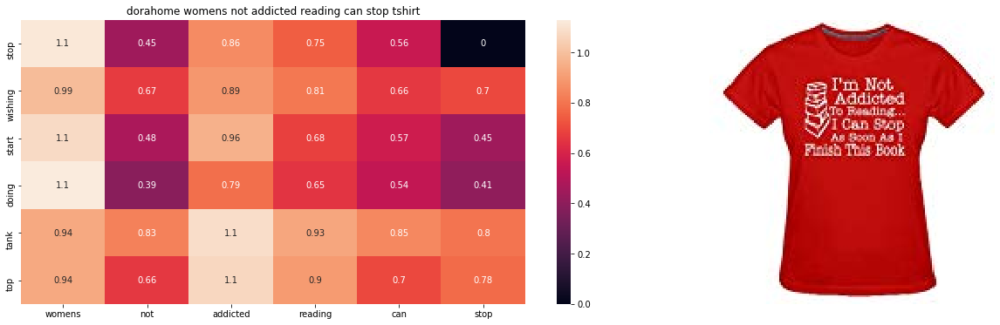

ASIN         : B0743KKGCY
BRAND        : Dorahome
COLOR        : red
TITLE        : dorahome womens not addicted reading can stop tshirt
COS/EUC_DIST :  2.53


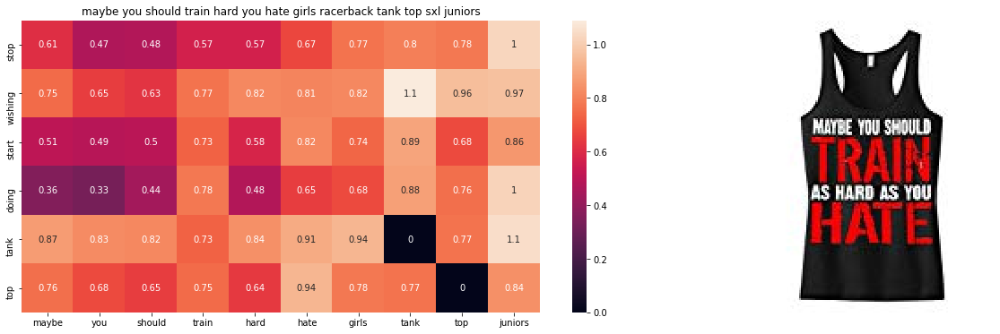

ASIN         : B00XLZXUYO
BRAND        : Interstate Apparel Inc
COLOR        : black
TITLE        : maybe you should train hard you hate girls racerback tank top sxl juniors
COS/EUC_DIST :  2.54


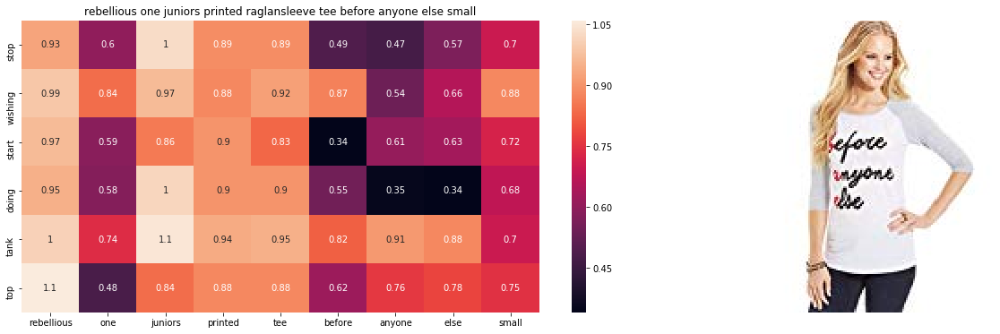

ASIN         : B00WW139KI
BRAND        : Rebellious One
COLOR        : white
TITLE        : rebellious one juniors printed raglansleeve tee before anyone else small
COS/EUC_DIST :  2.59


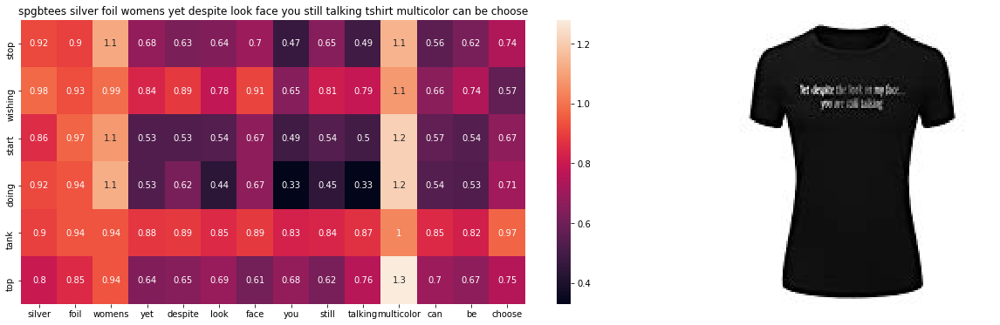

ASIN         : B0739QCVBQ
BRAND        : SPGBTees
COLOR        : black
TITLE        : spgbtees silver foil womens yet despite look face you still talking tshirt multicolor can be choose
COS/EUC_DIST :  2.62


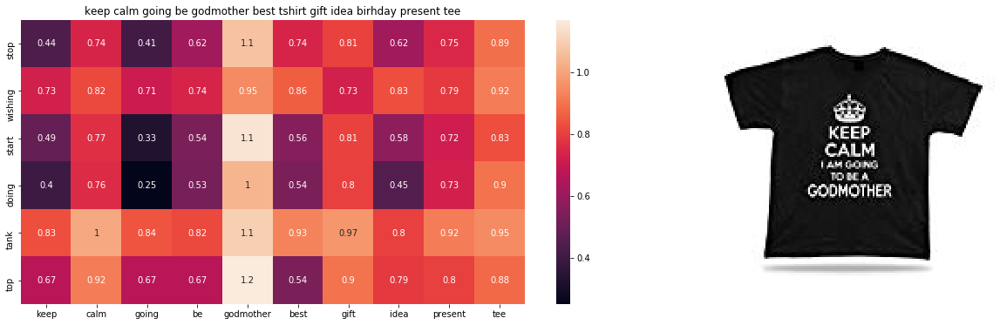

ASIN         : B01B2WO9LU
BRAND        : Body-soul-n-spirit
COLOR        : *
TITLE        : keep calm going be godmother best tshirt gift idea birhday present tee
COS/EUC_DIST :  2.63


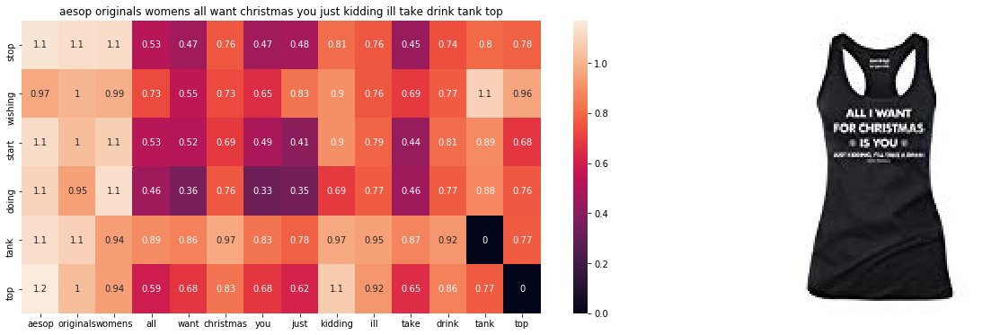

ASIN         : B01LFOSKJW
BRAND        : Aesop Originals
COLOR        : black
TITLE        : aesop originals womens all want christmas you just kidding ill take drink tank top
COS/EUC_DIST :  2.63


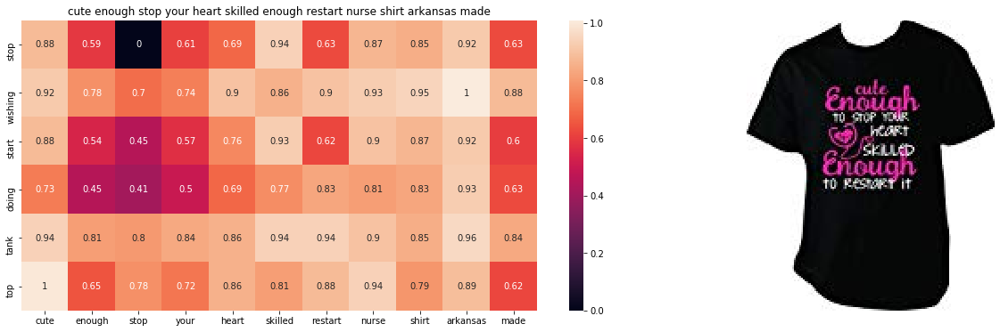

ASIN         : B01JJ86IVI
BRAND        : Arkansas Made
COLOR        : black
TITLE        : cute enough stop your heart skilled enough restart nurse shirt arkansas made
COS/EUC_DIST :  2.64


In [16]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=21256, num_rec=8, feat_type='w2v', vectorized_data=idf_glove_vecs,
                         word_vec_map=word_vec_map, word_idf_map=word_idf_map)

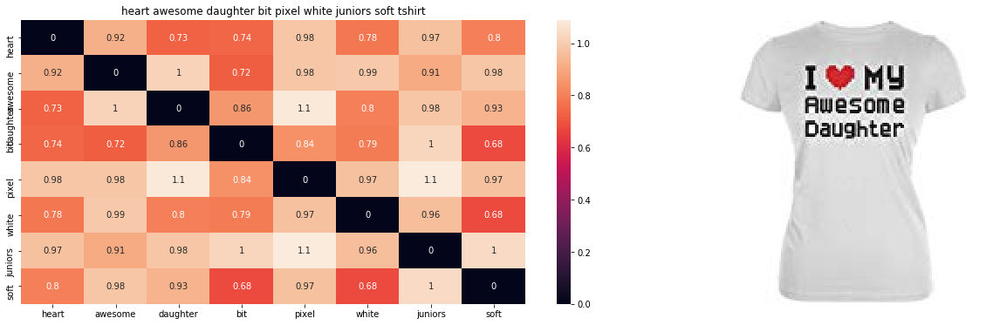

ASIN         : B00XQ9L2CC
BRAND        : Tee's Plus
COLOR        : white
TITLE        : heart awesome daughter bit pixel white juniors soft tshirt
COS/EUC_DIST :  0.00


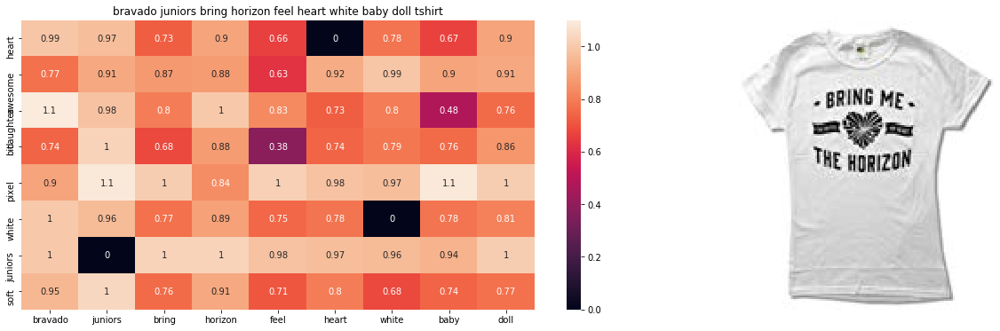

ASIN         : B00HWFHR70
BRAND        : Bay Island Sportswear
COLOR        : white
TITLE        : bravado juniors bring horizon feel heart white baby doll tshirt
COS/EUC_DIST :  2.32


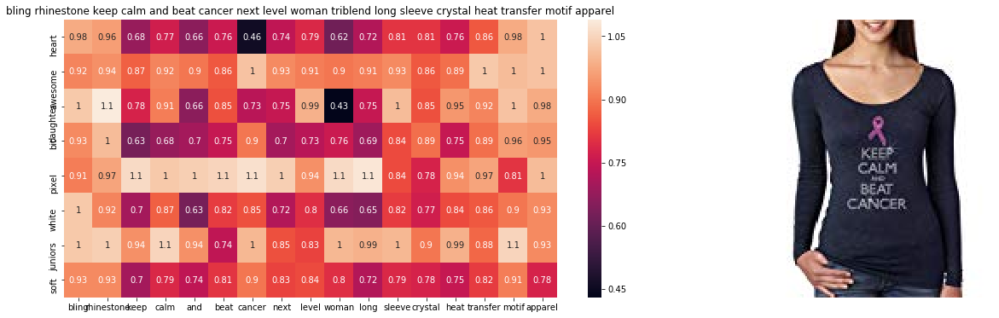

ASIN         : B019HI6JSC
BRAND        : Crystal Trends
COLOR        : green
TITLE        : bling rhinestone keep calm and beat cancer next level woman triblend long sleeve crystal heat transfer motif apparel
COS/EUC_DIST :  2.41


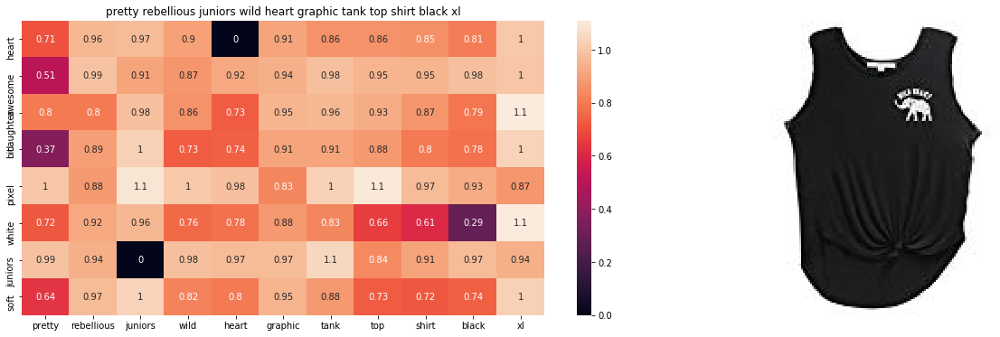

ASIN         : B074P9KPM4
BRAND        : Pretty Rebellious
COLOR        : black
TITLE        : pretty rebellious juniors wild heart graphic tank top shirt black xl
COS/EUC_DIST :  2.43


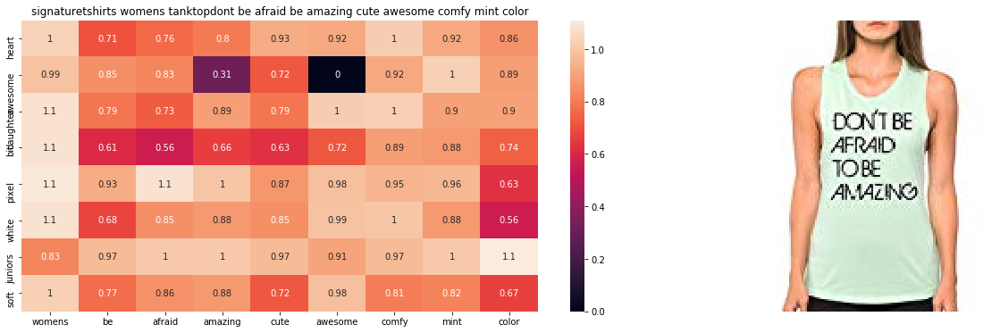

ASIN         : B075C1G5YN
BRAND        : signaturetshirts
COLOR        : mint
TITLE        : signaturetshirts womens tanktopdont be afraid be amazing cute awesome comfy mint color
COS/EUC_DIST :  2.44


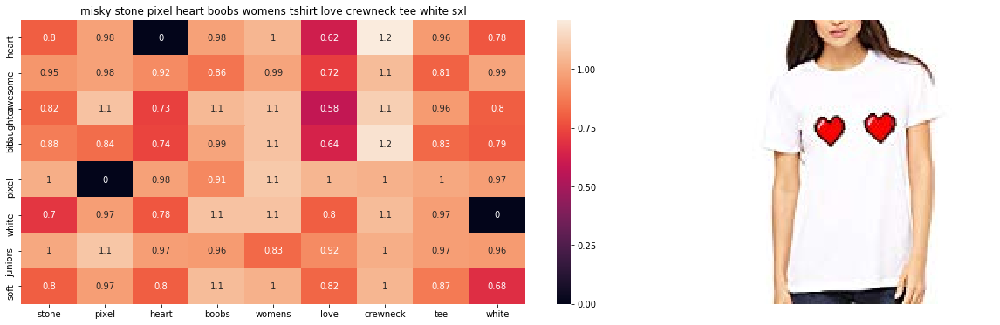

ASIN         : B06XFFFVM3
BRAND        : Misky & Stone
COLOR        : white
TITLE        : misky stone pixel heart boobs womens tshirt love crewneck tee white sxl
COS/EUC_DIST :  2.47


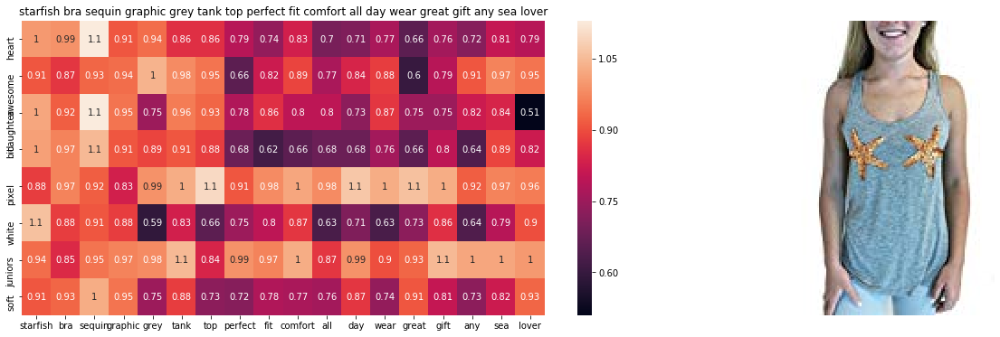

ASIN         : B0728L7X54
BRAND        : SHOP WTF
COLOR        : grey
TITLE        : starfish bra sequin graphic grey tank top perfect fit comfort all day wear great gift any sea lover
COS/EUC_DIST :  2.47


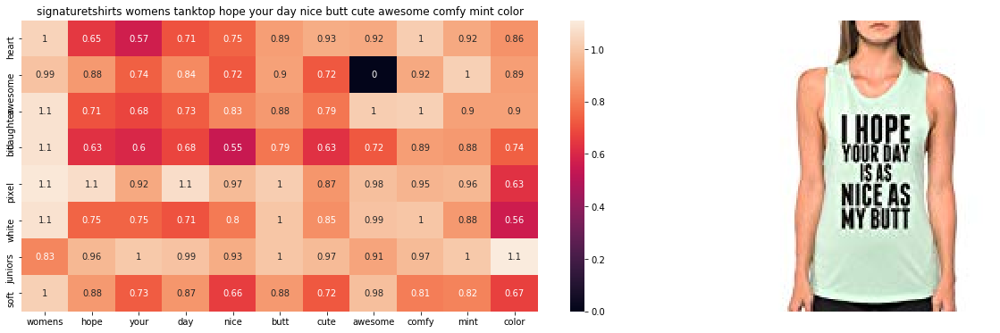

ASIN         : B075C295WC
BRAND        : signaturetshirts
COLOR        : mint
TITLE        : signaturetshirts womens tanktop hope your day nice butt cute awesome comfy mint color
COS/EUC_DIST :  2.47


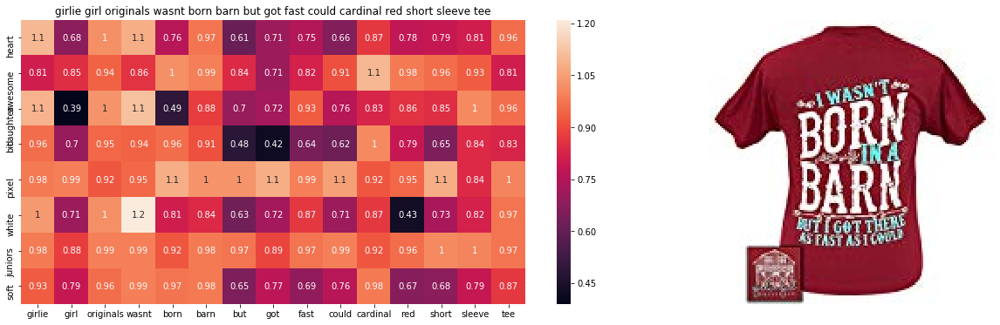

ASIN         : B06Y3CXNV7
BRAND        : Girlie Girl Originals
COLOR        : cardinal red
TITLE        : girlie girl originals wasnt born barn but got fast could cardinal red short sleeve tee
COS/EUC_DIST :  2.50


In [18]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=10580, num_rec=8, feat_type='w2v', vectorized_data=idf_glove_vecs,
                         word_vec_map=word_vec_map, word_idf_map=word_idf_map)

__IDF Recommendations seem to be diverse.__

### 5.1.4 Product Similarity using BRAND, COLOR and IDF Weighted GLOVE.

* We'll use the brand and color to generate the recommended values.
* Many of the columns do not contain brand info. We'll replace the null values by 'NO COLOR INFO'.

In [19]:
data.color.fillna('NO COLOR INFO', inplace=True)


data.brand = data.brand.apply(lambda brand_text : brand_text.replace(" ", "-"))
data.color = data.color.apply(lambda color_text : color_text.replace("*", "NO COLOR INFO"))
data.color = data.color.apply(lambda color_text : re.sub(r'[,&/. ]', '-', color_text))

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(data.brand)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(data.color)

#extra_features = hstack((brand_features , color_features)).tocsr()

__Recommendations from the same color an same brand__

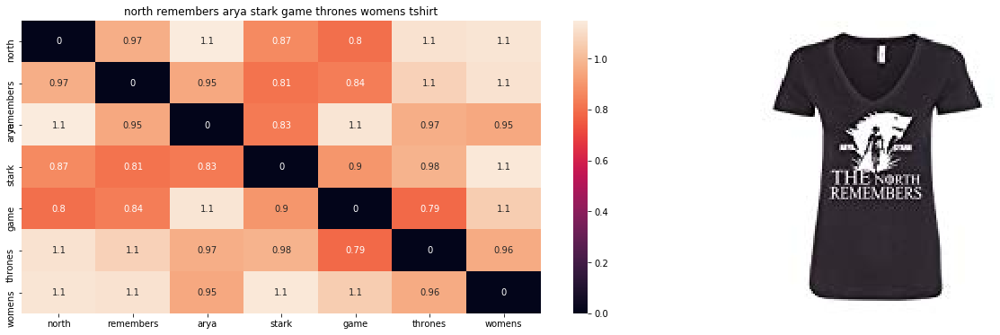

ASIN         : B07588QBDT
BRAND        : Motivashirts
COLOR        : black
TITLE        : north remembers arya stark game thrones womens tshirt
COS/EUC_DIST :  0.00


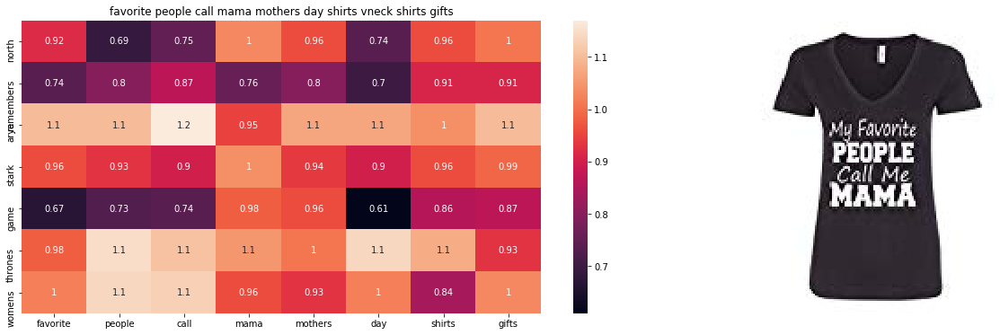

ASIN         : B071RKRBRC
BRAND        : Motivashirts
COLOR        : black
TITLE        : favorite people call mama mothers day shirts vneck shirts gifts
COS/EUC_DIST :  0.00


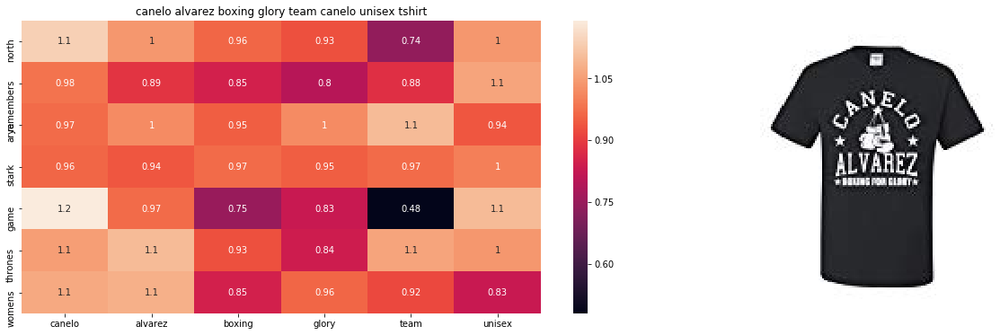

ASIN         : B07574J2WG
BRAND        : Motivashirts
COLOR        : black
TITLE        : canelo alvarez boxing glory team canelo unisex tshirt
COS/EUC_DIST :  0.00


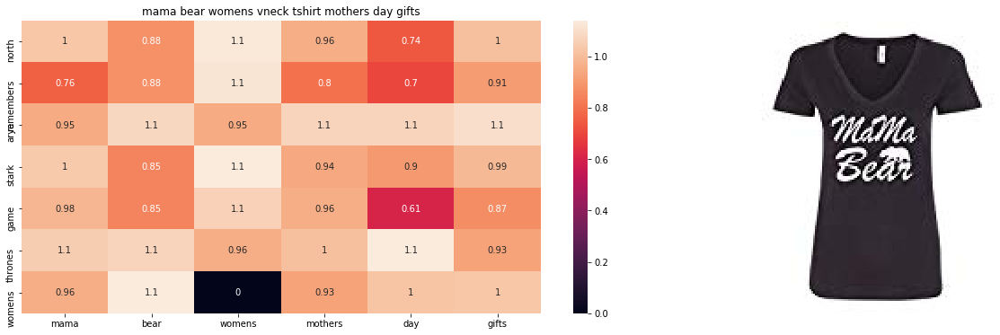

ASIN         : B0718WDNJ5
BRAND        : Motivashirts
COLOR        : black
TITLE        : mama bear womens vneck tshirt mothers day gifts
COS/EUC_DIST :  0.00


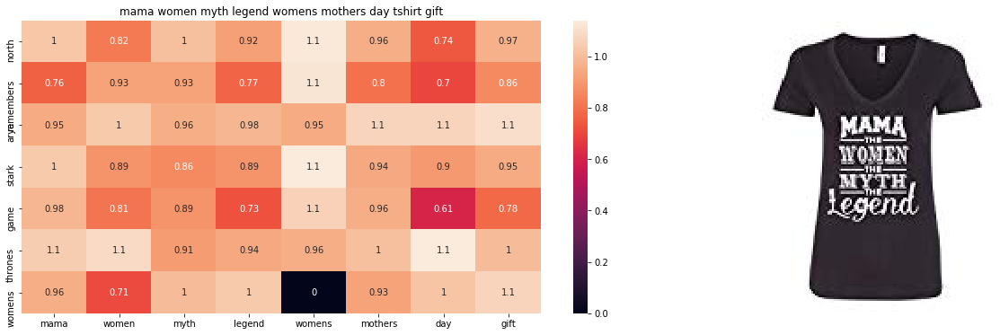

ASIN         : B072DV1SHC
BRAND        : Motivashirts
COLOR        : black
TITLE        : mama women myth legend womens mothers day tshirt gift
COS/EUC_DIST :  0.00


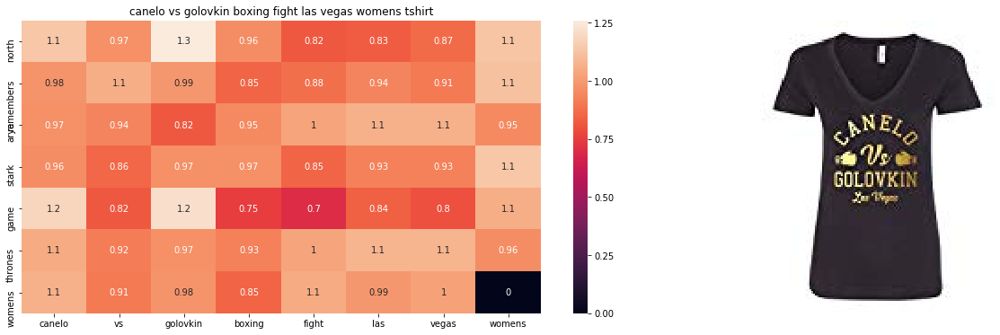

ASIN         : B075757WGZ
BRAND        : Motivashirts
COLOR        : black
TITLE        : canelo vs golovkin boxing fight las vegas womens tshirt
COS/EUC_DIST :  0.00


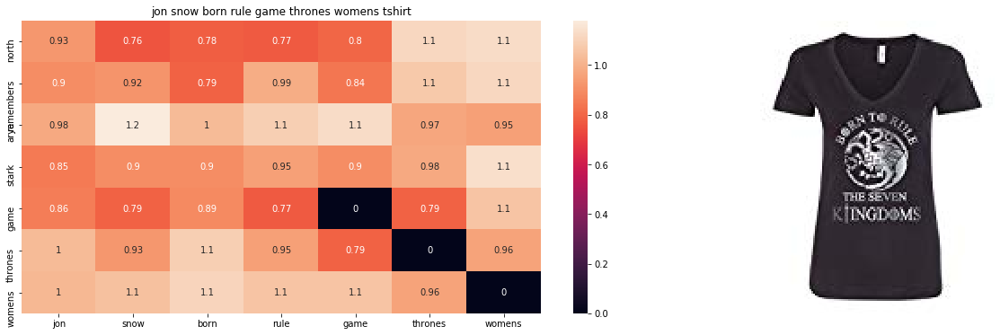

ASIN         : B0757ZSH4N
BRAND        : Motivashirts
COLOR        : black
TITLE        : jon snow born rule game thrones womens tshirt
COS/EUC_DIST :  0.00


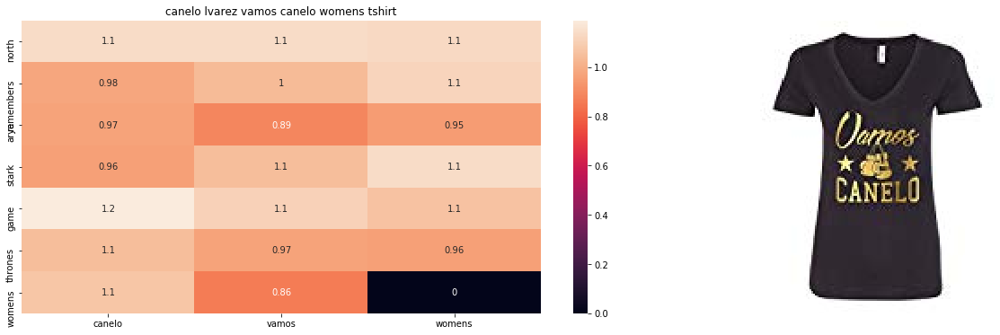

ASIN         : B0757VBB8D
BRAND        : Motivashirts
COLOR        : black
TITLE        : canelo lvarez vamos canelo womens tshirt
COS/EUC_DIST :  0.00


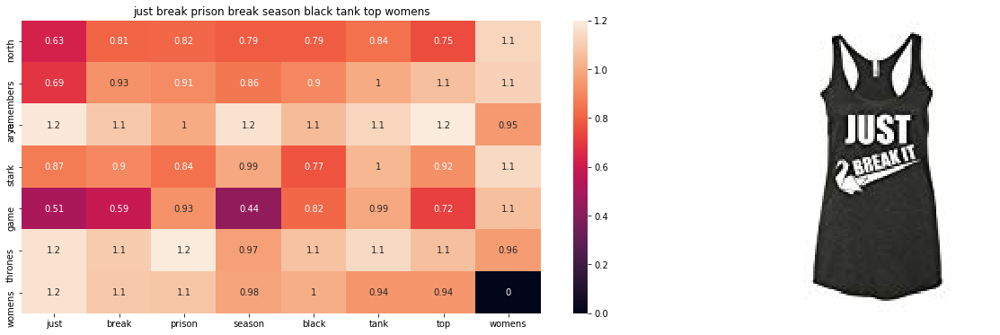

ASIN         : B0728HNHR9
BRAND        : Motivashirts
COLOR        : black
TITLE        : just break prison break season black tank top womens
COS/EUC_DIST :  0.00


In [20]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=22456, num_rec=8, feat_type='w2v',\
                         vectorized_data=idf_glove_vecs, word_vec_map=word_vec_map, word_idf_map=word_idf_map,\
                         extra_features=(brand_features, color_features), weights=[0, 50,  50])

__Weighted Recommendations__

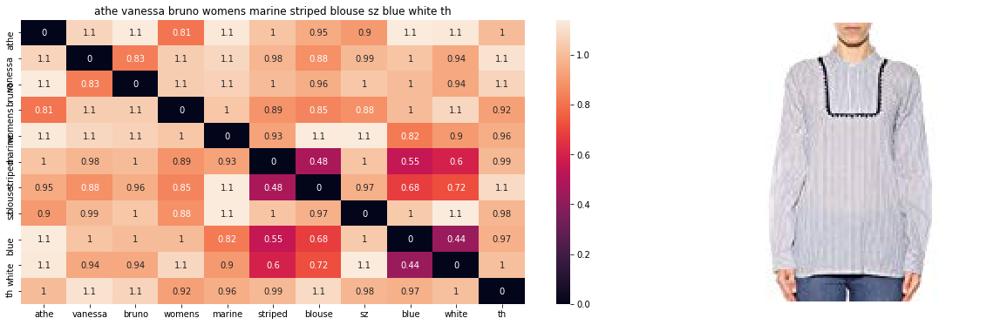

ASIN         : B074PFYDS6
BRAND        : Athe-Vanessa-Bruno
COLOR        : blue-white
TITLE        : athe vanessa bruno womens marine striped blouse sz blue white th
COS/EUC_DIST :  0.00


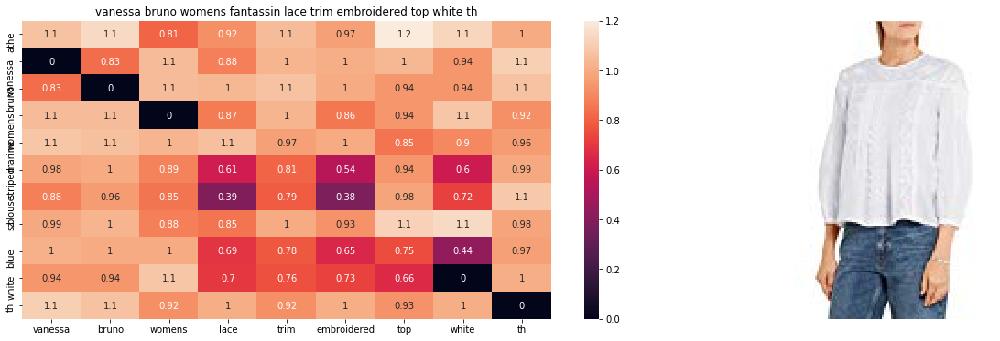

ASIN         : B074PCNV8Z
BRAND        : Vanessa-Bruno
COLOR        : white
TITLE        : vanessa bruno womens fantassin lace trim embroidered top white th
COS/EUC_DIST :  1.46


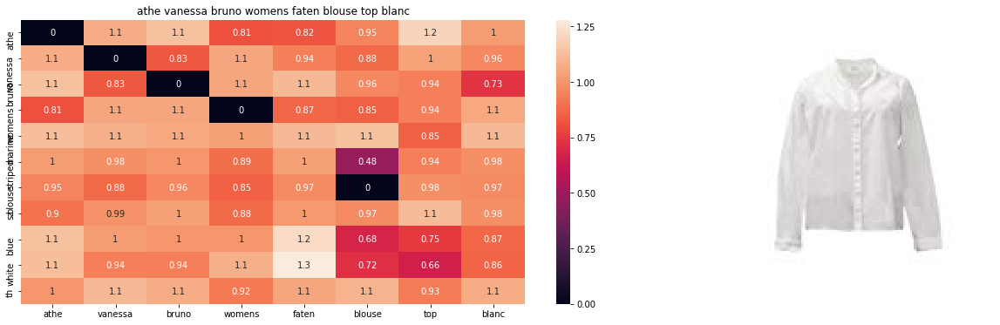

ASIN         : B074PCWCJZ
BRAND        : Athe-Vanessa-Bruno
COLOR        : blanc
TITLE        : athe vanessa bruno womens faten blouse top blanc
COS/EUC_DIST :  1.64


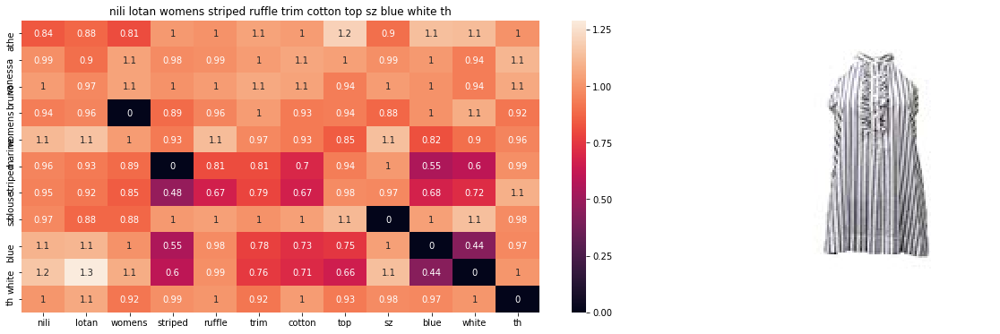

ASIN         : B074PFR9CF
BRAND        : Nili-Lotan
COLOR        : blue-white
TITLE        : nili lotan womens striped ruffle trim cotton top sz blue white th
COS/EUC_DIST :  1.65


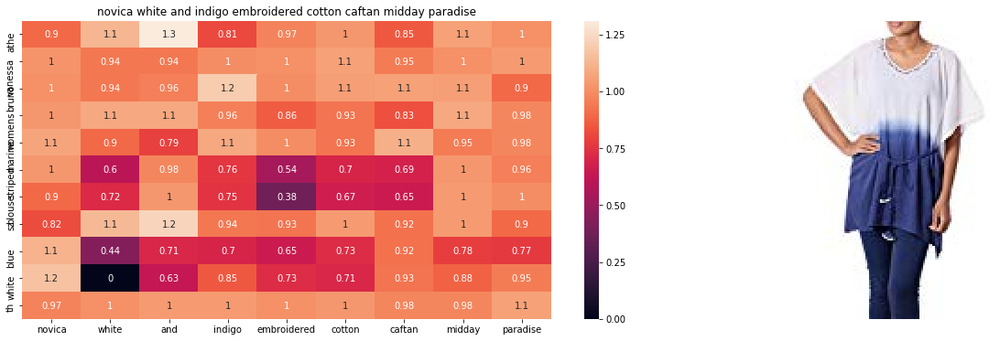

ASIN         : B06Y1CZZPZ
BRAND        : NOVICA
COLOR        : blue--white
TITLE        : novica white and indigo embroidered cotton caftan midday paradise
COS/EUC_DIST :  1.76


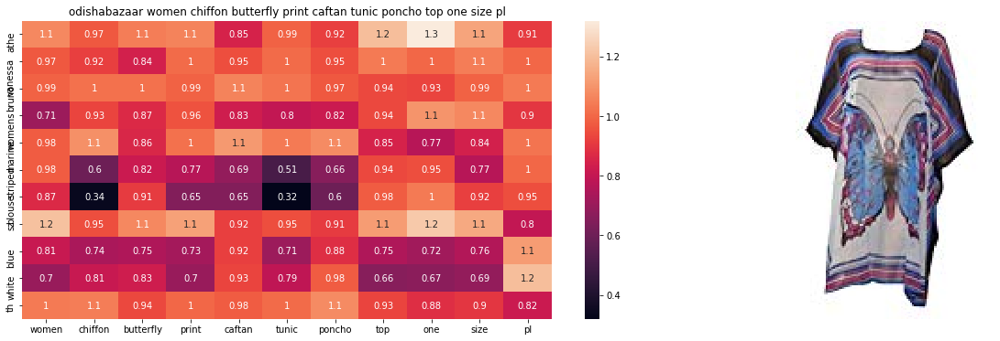

ASIN         : B06XV8RDLG
BRAND        : Odishabazaar
COLOR        : white-blue
TITLE        : odishabazaar women chiffon butterfly print caftan tunic poncho top one size pl
COS/EUC_DIST :  1.78


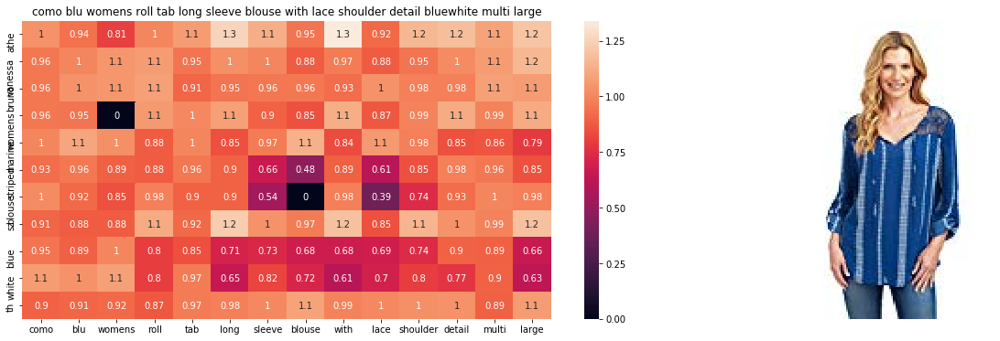

ASIN         : B071G6MX7W
BRAND        : Como
COLOR        : blue-white
TITLE        : como blu womens roll tab long sleeve blouse with lace shoulder detail bluewhite multi large
COS/EUC_DIST :  1.81


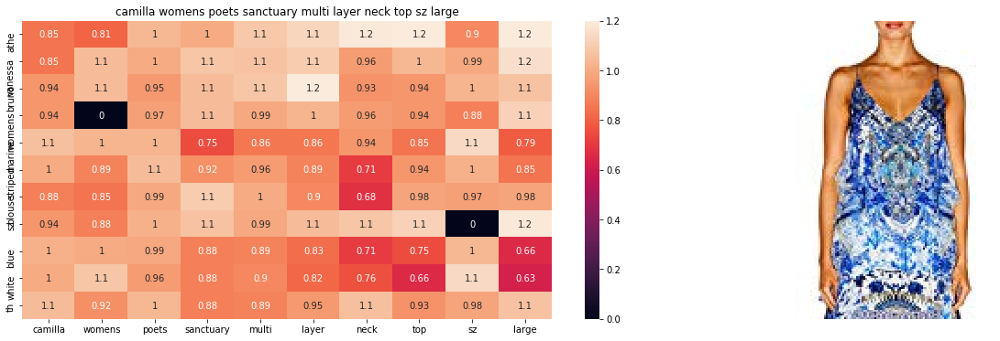

ASIN         : B0753CBZV5
BRAND        : Camilla
COLOR        : white--blue
TITLE        : camilla womens poets sanctuary multi layer neck top sz large
COS/EUC_DIST :  1.82


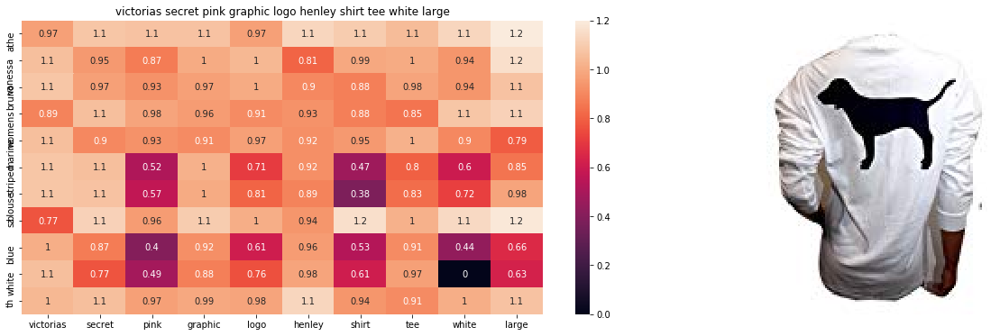

ASIN         : B06ZY63K28
BRAND        : V.-Secret
COLOR        : white---blue
TITLE        : victorias secret pink graphic logo henley shirt tee white large
COS/EUC_DIST :  1.83


In [21]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=556, num_rec=8, feat_type='w2v',\
                         vectorized_data=idf_glove_vecs, word_vec_map=word_vec_map, word_idf_map=word_idf_map,\
                         extra_features=(brand_features, color_features), weights=[60, 40,  40])

__Most of the recommendations are diverse.__<br>
__Our Weighted Scheme seems to be working well.__

### 5.1.5 Product Similarity using Visual Features, GLOVE weighted by IDF and (COLOR, BRAND) Features.

* Now that we have used GLOVE Weighted by IDF and (BRAND, COLOR) features. 
* Let's also use the features of image in computing the similarity between the apparels.

__1. CONVOLUTION_NEURAL_NETWORKS are very good at claasifying images.__<br>
__2. The last layers of the CNNs can be used as feature extractors.__<br>
__3. We'll use the pretrained VGG16 CNN to extract the features.__<br>
__4. The dimension of the last layer is (7, 7, 512). For every image we pass through the CNN, it returns (7, 7, 512)D vector.__<br>
__5. The vectors thus extracted from each image are used to compute the similarity between apparels.__

<pre>
        +--------------+         +----------+          +----------------+                    +----------+
        |              |         |          |          |                |                    |          |
        |     IMAGE    |         |   PRE    |          |                |                    |          |
        |  (reshaped)  |  ===>   |  TRAINED |   ===>   |   (7, 7, 512)  |   ===(reshape)==>  |  25088D  |        
        |  (224, 224)  |         |   VGG16  |          |    VECTOR      |                    |  VECTOR  |
        |              |         |          |          |                |                    |          |
        +--------------+         +----------+          +----------------+                    +----------+

In [12]:
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import VGG16

Using TensorFlow backend.


__Downloading the Images__

## time taken to run : 45MIN

no_image_asins = []

for idx, row in tqdm(data.iterrows()):
    try:
        response = requests.get(row.medium_image_url)
        Image.open(BytesIO(response.content)).convert('RGB').save(os.path.join('28K_IMAGES/', row.asin +'.jpeg'), 'JPEG')
    
    except Exception:
        #NO IMAGE AVAILABLE
        no_image_asins.append(idx)
        print(idx, end=" ")
        response = requests.get('https://goo.gl/a2Bp8j')
        Image.open(BytesIO(response.content)).convert('RGB').save(os.path.join('28K_IMAGES/', row.asin +'.jpeg'), 'JPEG')

__Generating the features from Images__

In [16]:
## time taken to run on GTX 950M : 45MIN

bs = 33 #batch size (use multiples of data.shape[0])
img_w, img_h = (224, 224) #input_image size, all the images will be reshaped to

datagen = ImageDataGenerator(rescale=1./255)
generator = datagen.flow_from_directory(directory='data/',
                                        target_size=(img_w, img_h),
                                        batch_size=bs,
                                        class_mode=None,
                                        shuffle=False)

#the asins are stored in alphabetical order which is same as the data.asins
asins = list(map(lambda f : os.path.split(f)[1].split(".")[0], generator.filenames))

#
model = VGG16(include_top=False, weights='imagenet')
image_features = model.predict_generator(generator, steps=data.shape[0]//bs)
image_features = image_features.reshape(data.shape[0], -1)

np.save(open('28K_IMAGE_features.npy', 'wb'), image_features)
np.save(open('28K_IMAGE_asins.npy', 'wb'), np.array(asins))

Found 27918 images belonging to 1 classes.


In [22]:
image_features = np.load('28K_IMAGE_features.npy')

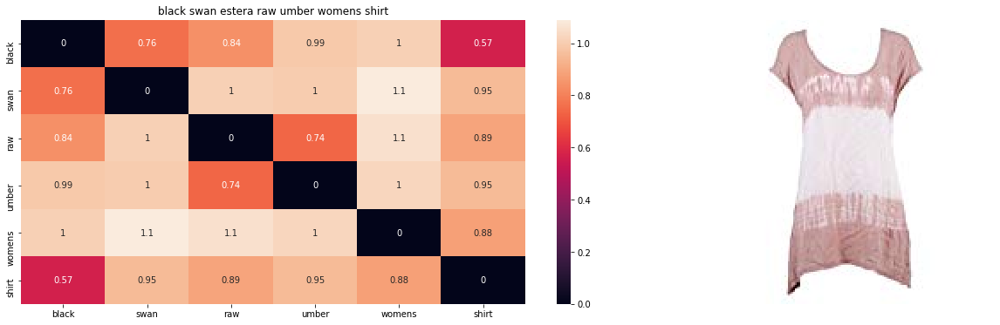

ASIN         : B06Y1VN8WQ
BRAND        : Black-Swan
COLOR        : raw-umber
TITLE        : black swan estera raw umber womens shirt
COS/EUC_DIST :  0.01


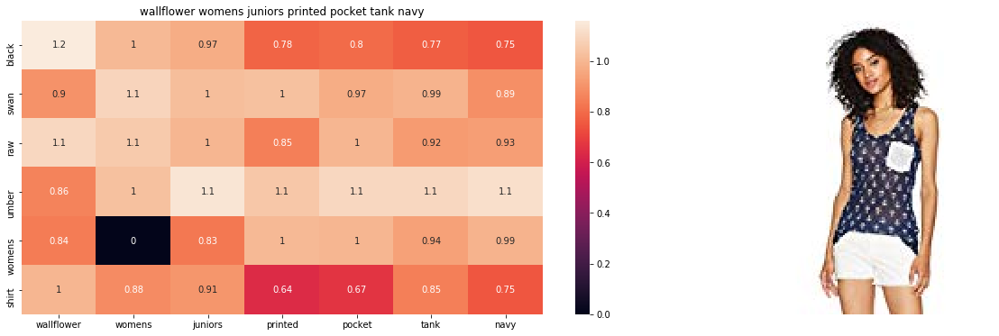

ASIN         : B01N0TMY3W
BRAND        : WallFlower-Jeans
COLOR        : navy
TITLE        : wallflower womens juniors printed pocket tank navy
COS/EUC_DIST :  7.41


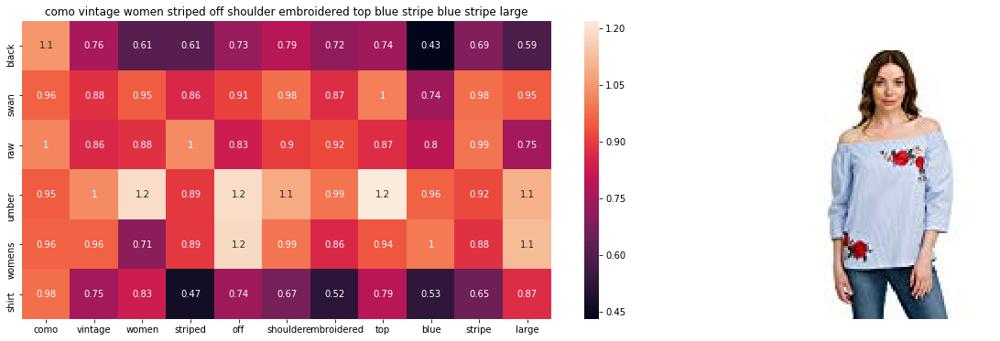

ASIN         : B0725LMTVG
BRAND        : Como-vintage
COLOR        : blue-stripe
TITLE        : como vintage women striped off shoulder embroidered top blue stripe blue stripe large
COS/EUC_DIST :  7.44


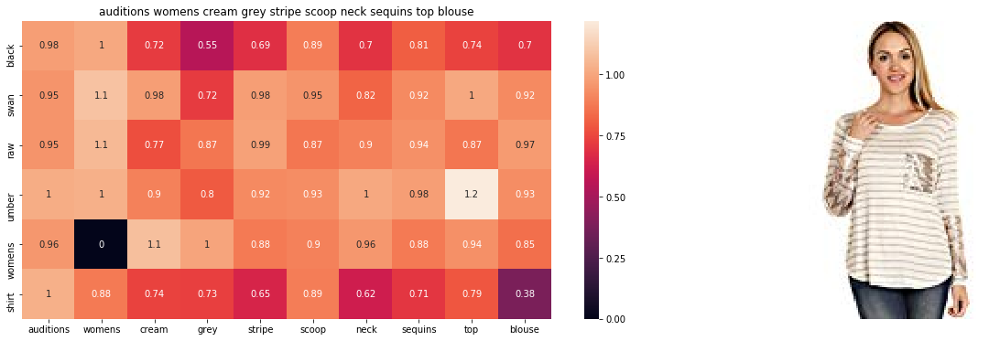

ASIN         : B0743VZHGS
BRAND        : Auditions
COLOR        : cream
TITLE        : auditions womens cream grey stripe scoop neck sequins top blouse
COS/EUC_DIST :  7.62


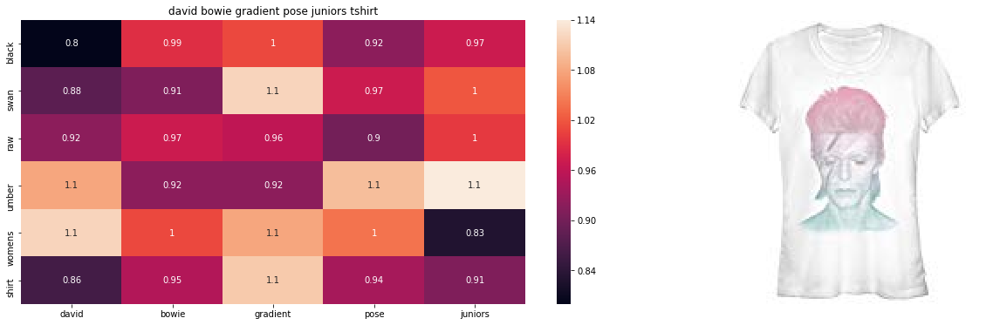

ASIN         : B01B1QLCI0
BRAND        : David-Bowie
COLOR        : white
TITLE        : david bowie gradient pose juniors tshirt
COS/EUC_DIST :  7.62


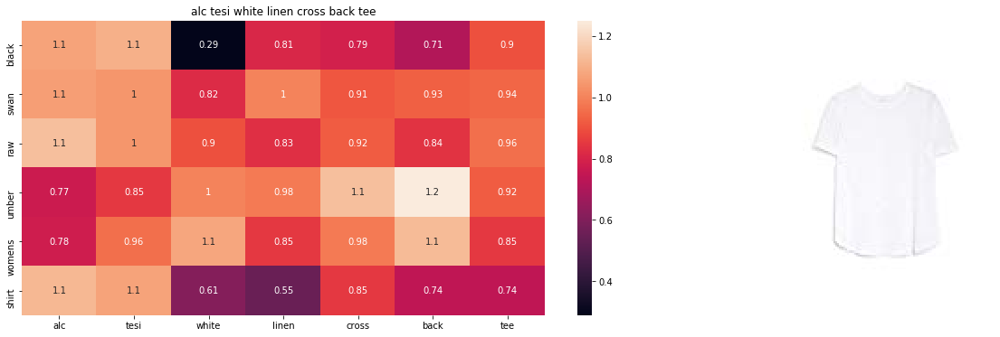

ASIN         : B06ZY8FFRW
BRAND        : A.L.C.
COLOR        : white
TITLE        : alc tesi white linen cross back tee
COS/EUC_DIST :  7.63


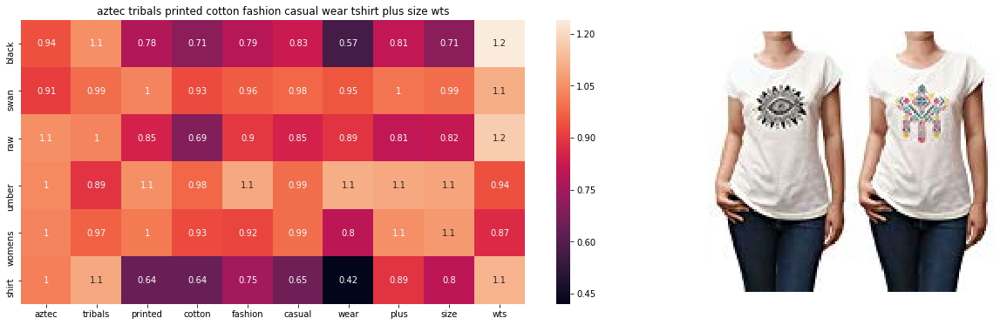

ASIN         : B01MZBTUIR
BRAND        : Vietsbay
COLOR        : aztec-tribals
TITLE        : aztec tribals printed cotton fashion casual wear tshirt plus size wts
COS/EUC_DIST :  7.65


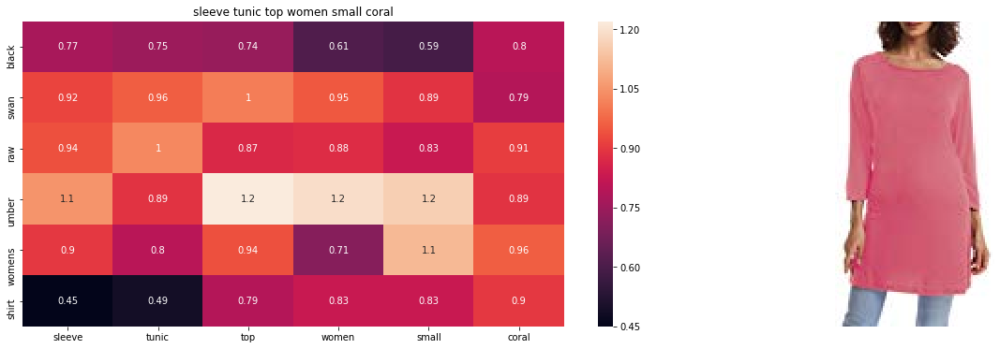

ASIN         : B072M78BBX
BRAND        : TBONTB
COLOR        : coral
TITLE        : sleeve tunic top women small coral
COS/EUC_DIST :  7.67


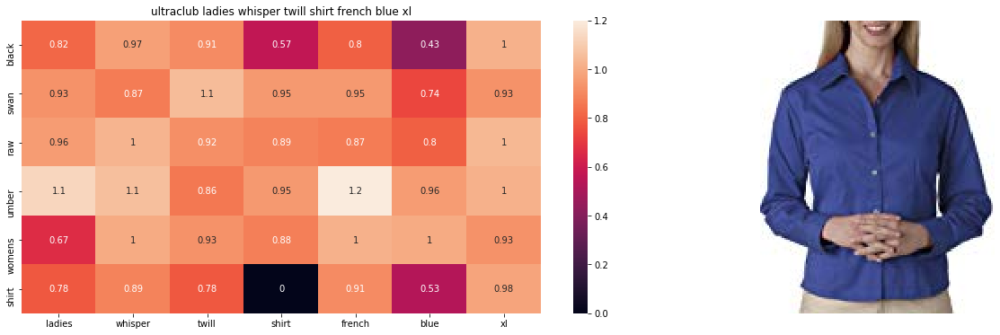

ASIN         : B006R7UTU6
BRAND        : UltraClub
COLOR        : french-blue
TITLE        : ultraclub ladies whisper twill shirt french blue xl
COS/EUC_DIST :  7.80


In [23]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=2986, num_rec=8, feat_type='w2v',\
                         vectorized_data=idf_glove_vecs, word_vec_map=word_vec_map, word_idf_map=word_idf_map,\
                         extra_features=(brand_features, color_features, image_features), weights=[10, 30, 30, 10])

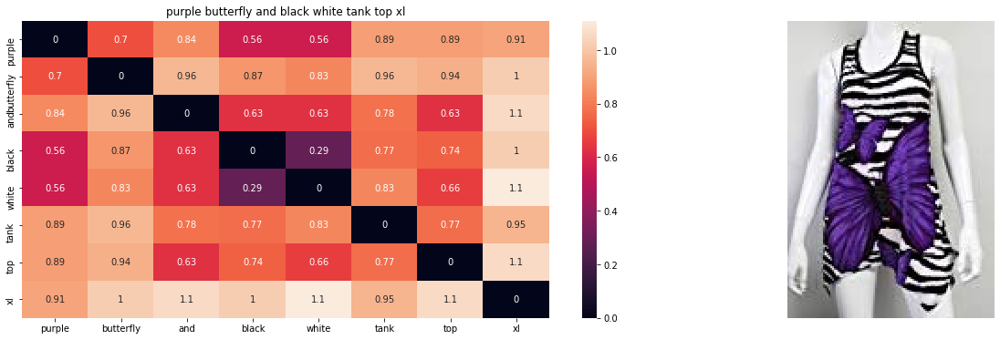

ASIN         : B00JV6399S
BRAND        : Si-Row
COLOR        : purple
TITLE        : purple butterfly and black white tank top xl
COS/EUC_DIST :  0.00


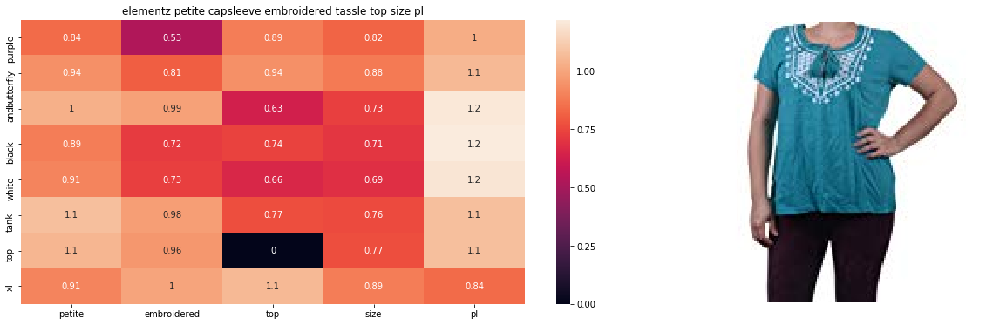

ASIN         : B0176V4NCQ
BRAND        : Elementz
COLOR        : jade
TITLE        : elementz petite capsleeve embroidered tassle top size pl
COS/EUC_DIST :  35.85


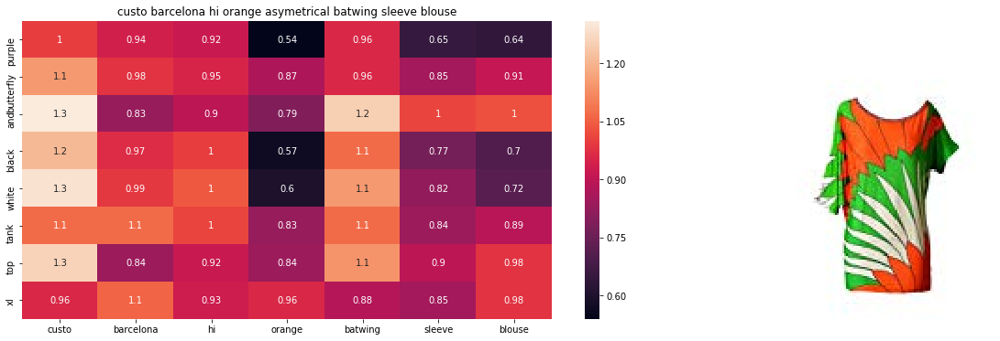

ASIN         : B01LY21H62
BRAND        : Custo-Barcelona
COLOR        : orange-multi
TITLE        : custo barcelona hi orange asymetrical batwing sleeve blouse
COS/EUC_DIST :  35.97


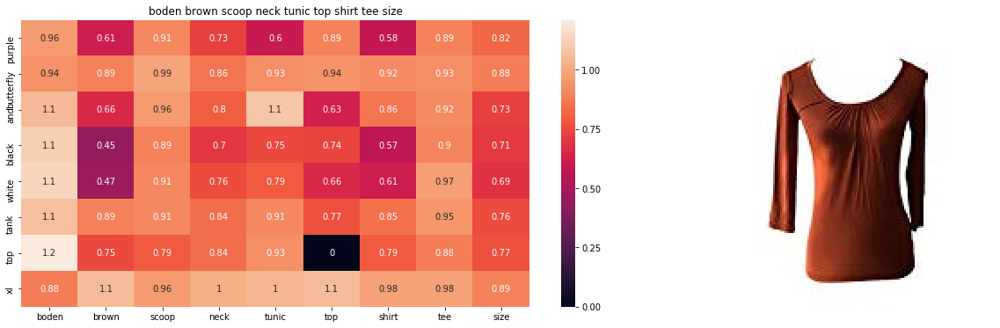

ASIN         : B0718ZFSY7
BRAND        : BODEN
COLOR        : brown
TITLE        : boden brown scoop neck tunic top shirt tee size
COS/EUC_DIST :  36.92


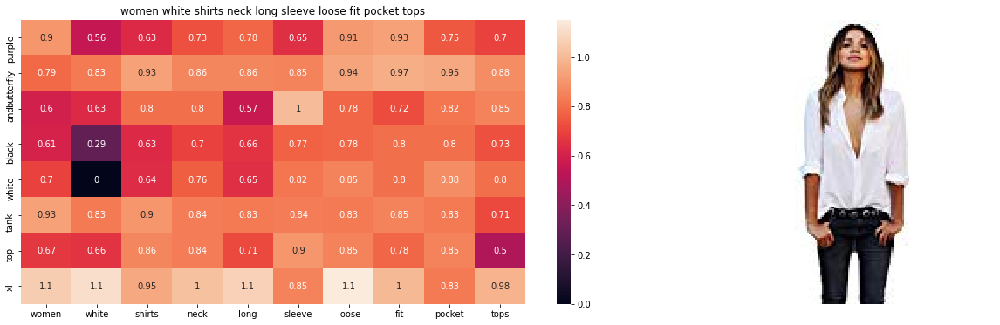

ASIN         : B06XWDZVWM
BRAND        : Shensee-#-Fashion-Tees
COLOR        : white
TITLE        : women white shirts neck long sleeve loose fit pocket tops
COS/EUC_DIST :  37.08


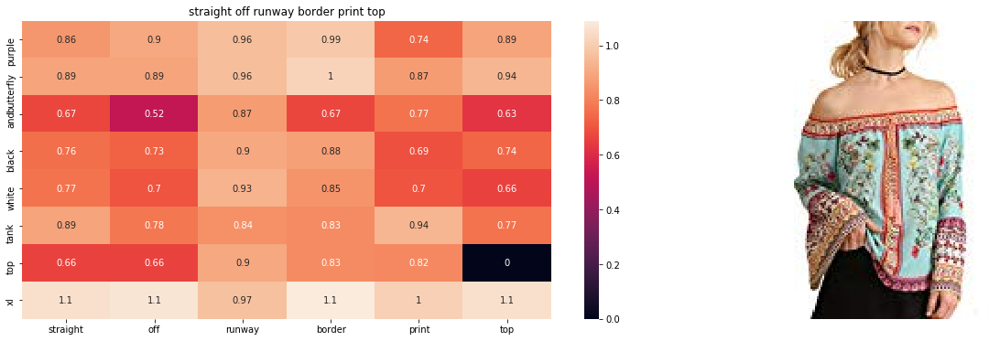

ASIN         : B071NDYS58
BRAND        : Umgee
COLOR        : aqua
TITLE        : straight off runway border print top
COS/EUC_DIST :  37.97


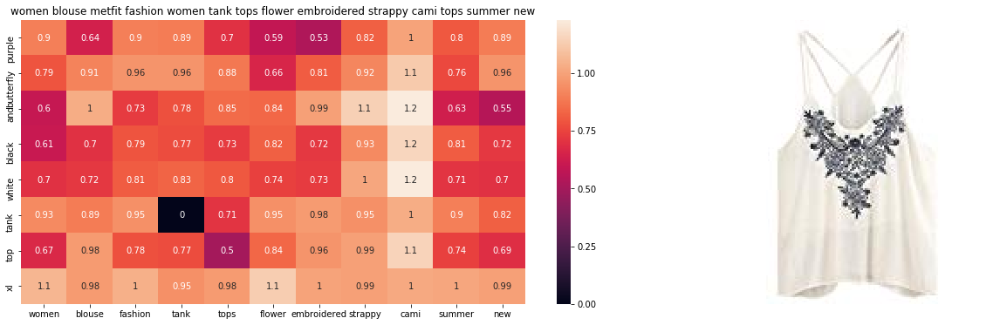

ASIN         : B06WD85FNY
BRAND        : METFIT
COLOR        : white
TITLE        : women blouse metfit fashion women tank tops flower embroidered strappy cami tops summer new
COS/EUC_DIST :  38.05


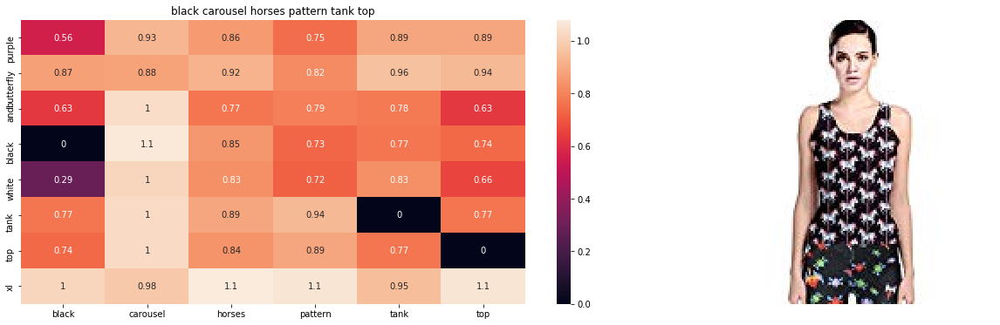

ASIN         : B00XUL5RFO
BRAND        : CowCow
COLOR        : black
TITLE        : black carousel horses pattern tank top
COS/EUC_DIST :  38.19


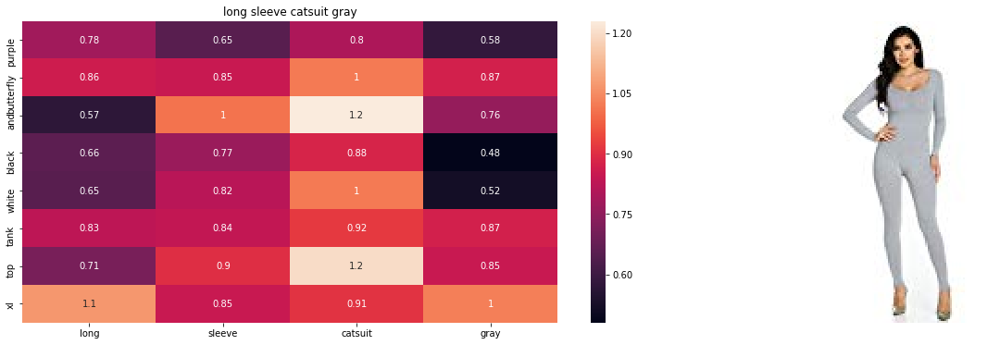

ASIN         : B01NCJQC02
BRAND        : SOHO-GLAM
COLOR        : gray
TITLE        : long sleeve catsuit gray
COS/EUC_DIST :  38.24


In [24]:
#__Using Index to get the recommendations__
generate_recommendations(data=data, query=18146, num_rec=8, feat_type='w2v',\
                         vectorized_data=idf_glove_vecs, word_vec_map=word_vec_map, word_idf_map=word_idf_map,\
                         extra_features=(brand_features, color_features, image_features), weights=[0, 0, 0, 100])

__1. When the weight of visual_features is set to high, some of the recommedations apparels appear so random while some of the match the pattern/print.__<br>
__2. By observing multiple recommendations with different setting of weights, it seems that visual features had very little impact on the outcome.__<br>
__3. This visual features had significance when there was a pattern or print on the apparel. Since the images we used are upscaled, we may had better chances using high res images.__<br>

# [6] Conclusion

__To summarize the whole.__

1) It is important that we study and understand the data inorder to build better featurization techniques.

2) Most of the data contained near duplictes, which had been issue if they hadn't been removed.

2) We've used various ways to encode the apparel's title, brand, color and image info into features.
    - Text based Bag of Words
    - Text based TFIDF
    - Text based GLOVE weighted by IDF
    - Text based GLOVE weighted by IDF, brand and color features
    - Text based GLOVE weighted by IDF, brand, color and Visual features.
    
    
3) We've used two metrics to calculate the similarity between features.
    - *Euclidean_Distance* seems to work well when using visual features.
    - *Cosine_Distance* seems to work a bit better when using all the featurizations.
    
    
4) The performance of various featurizations is highly subjective.
    - The bow and tfidf recommendations looked like they came from a cluster.
    - The recommendations when using IDF weighted GLOVE seem to be more diverse and appealing.
    - The visual features had little to no impact in the recommendations.
    - When a pattern exists on the apparel, it seems to recommend the similar pattern apparels.
    
5) The set of above recommendation systems is purely based on the apparels information.

6) The recommendations could've been more interesting if we somehow encoded the user data, behaviour and preferences into our features.

__End Of Notebook__